# **PSI Numerical Methods**
## Winter 2024
### **Homework Assignment 2: Partial Differential Equations**
**Submitted by:** Asif Ayub  
**Date:** 12 March 2024 *(super late)*

The main goal of this homework is to solve the scalar wave equation  
\begin{equation}
    \partial_t^2\phi=\Delta\phi
\end{equation}
on the surface of a sphere. To discretize $\phi(t, \theta, \varphi)$ in space, we recommend using spherical harmonic functions $Y_{lm}$. The Laplace operator for spherical harmonics is a diagonal operator given by the factor $−l(l + 1)$ for each $c^{lm}$ (i.e., it is independent of the mode number $m$). This will lead to a system of ODEs for the coefficient vector $c^{lm}$.  
  
To discretize $\phi$ in time, we want to use standard ODE methods. These standard methods assume that there is only a first derivative in time. We thus introduce a new function $\psi=\partial_t\phi$, arriving at the system  
\begin{align}
    \partial_t\phi &=\psi \\  
    \partial_t\psi &=\Delta\phi
\end{align}
Both functions $\phi$ and $\psi$ need to be expanded in spherical harmonics, i.e., the coefficient vector is now twice as long.  
  
Note: You can use the package `SphericalFunctions` to obtain the spherical harmonics functions $Y_{lm}$

## **Questions**  
**(a) Numerically implement the discretization of $\phi$ in terms of spherical harmonics.**

To start, we decompose the function $\phi$ in terms of spherical harmonics, which form a complete orthonormal basis:  
$$\phi(t,\theta,\varphi)=c^{lm}\, Y_{lm}(\theta,\varphi)$$  
Inserting this ansatz into the Poisson equation, we end up with the second order ordinary differential equation (ODE):
\begin{align*}
     \ddot{c}^{lm}(t)\, Y_{lm}(\theta,\varphi)&=-l(l+1)c^{lm}(t) Y_{lm}(\theta,\varphi) \\
    \Longrightarrow \ddot{c}^{lm}(t)&=-l(l+1)c^{lm}(t)
\end{align*}  

This appears to be a much nicer equation to solve. But this hides quite a bit of complexity. For instance, we need infinitely many $l,m$ values in principle to get a perfect decomposition of $\phi$. These correspond to $l\times m$ sets of differential equations. In our code, we cap the number of terms in the expansion.

In [1]:
# The most miserable part of the whole code (loading packages)
# using Pkg
# Pkg.add("SphericalHarmonics")
# Pkg.add("HCubature")
# Pkg.add("DifferentialEquations")
# Pkg.add("PyCall")
# using PyCall
# Pkg.add("PyPlot")
using Plots; pyplot()
# using PyPlot
using SphericalHarmonics
using HCubature
using DifferentialEquations

In [2]:
# Spherical coordinate definition
N = 100 # Spherical grid size
θ = LinRange(0,π,N);
ϕ = LinRange(0,2π,N);
# Cartesian projections of spherical coordinate (θ,ϕ')
X = sin.(θ) .* cos.(ϕ');
Y = sin.(θ) .* sin.(ϕ');
Z = cos.(θ) .* ones(N)';

**(b) Use an initial condition that is peaked around the North Pole, i.e., that looks similar to a Gaussian with a width equal to 0.2. (The exact initial condition does not matter).**

In [3]:
# Function to extract Y_lm coefficients given an initial distribution
# Init = Initial Condition, the Gaussian in our case
# l_max = Number of terms l in C_lm expansion
function C_lm(Init, l_max) 
    coefficients = hcubature(x -> computeYlm(x[1], x[2], l_max) * Init(x[1], x[2]), [0.0, 0.0], [pi, 2*pi])[1]
    return coefficients
end

C_lm (generic function with 1 method)

In [4]:
# Generates the Gaussian initial condition for a given (θ,ϕ) coordinate
function Gaussian(θ,ϕ)
    return exp(-θ^2 / (2 * 0.2)^2)
end

Gaussian (generic function with 1 method)

In [5]:
Phi_gauss = zeros(Complex{Float64}, 100, 100)

for i in 1:100
    for j in 1:100
        Phi_gauss[i,j] = Gaussian(0 + pi/100 * i, 0 + pi/50 * j)
    end
end

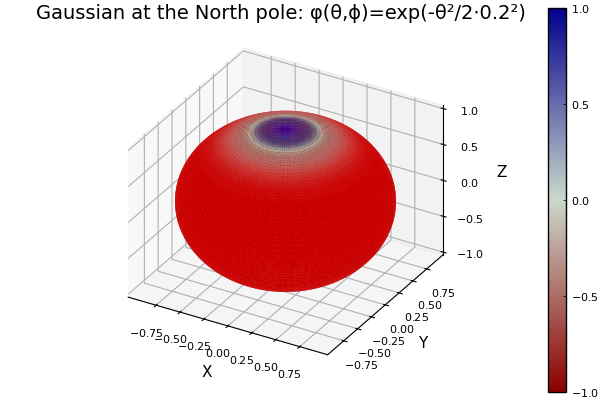

In [6]:
surface(X,Y,Z,fill_z=real.(Phi_gauss),c=:redsblues,xlabel ="X",ylabel="Y",zlabel="Z",title="Gaussian at the North pole: φ(θ,ϕ)=exp(-θ²/2⋅0.2²)")

The above plot shows what a Gaussian (with azimuthal symmetry) looks like on a sphere. We will now attempt to recreate this using the $Y_{lm}$ (spherical harmonics) decomposition.

In [7]:
Phi_gauss = C_lm(Gaussian,10)

Phi_t = zeros(Complex{Float64}, 100, 100)
for l in 1:100
    for m in 1:100
        Phi_t[l,m] = Phi_gauss' * computeYlm(0 + pi/100 * l, 0 + pi/50 * m, 10) / 100
    end
end

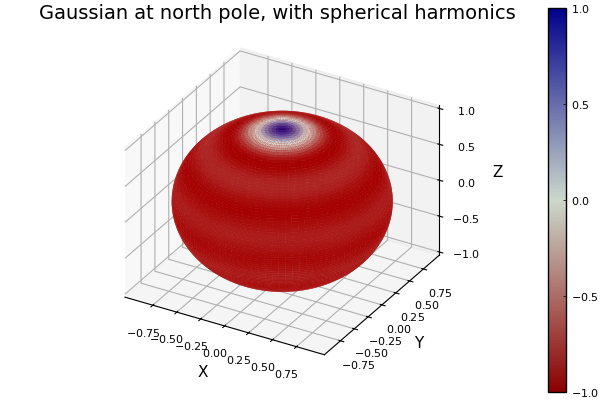

In [8]:
surface(X,Y,Z,fill_z=real.(Phi_t),c=:redsblues,xlabel ="X",ylabel="Y",zlabel="Z",title="Gaussian at north pole, with spherical harmonics")

Comparing the 2 figures above, we find that using $l_{max}=10$, we can successfully recreate the Gaussian initial condition.

**(c) Evolve the system in time to see from $t = 0$ to $t = 10$ using your favorite ODE integrator. The resulting evolution should look similar to water waves moving on the surface of a pond, except that the pond is the surface of a sphere.**

For a given value of $l$, we have to consider $(2l+1)$ $m$ values. This corresponds to $2l+1$ system of ODEs.

In [9]:
function lm(l_max)
    llmm = []
    for i in 1:l_max + 1
        append!(llmm, fill(i - 1, 2i - 1))
    end
    return llmm
end

lm (generic function with 1 method)

Next, we define the set of ODEs that have to be solved. We have the second-order equation  
$$\ddot{c}^{lm}(t)=-l(l+1)c^{lm}(t)$$  
Which we write as 2 coupled first order equations  
\begin{align*}
    \dot{c}^{lm} &= u^{lm}\\
    \dot{u}^{lm} &= -l(l+1)c^{lm}
\end{align*}
We specified the Gaussian initial condition and set the initial velocities randomly.

In [10]:
function ODE_system!(dc, c, p, t)
    l = p[1]
    dc[1] = c[2]  # First derivative of c
    dc[2] = - l * (l + 1) * c[1]  # Second derivative of c
end

ODE_system! (generic function with 1 method)

In [11]:
l_max = 20;

# Initial conditions in terms of coefficients C_lm
C0 = C_lm(Gaussian, l_max);
Der_C0 = rand(length(C0));

# Time range for solution
trange = (0.0, 10.0);

# Defining l,m values for each c
lm_ = lm(l_max); 

In [12]:
# Array to store solutions
SolnArray = []

# Solve the ODE for each l,m value
for i in 1:length(lm_)
    l = lm_[i]
    prob = ODEProblem(ODE_system!, [C0[i], Der_C0[i]], trange, [l])
    Sol = solve(prob)
    push!(SolnArray, Sol)
end

In [13]:
# Ordering the solutions in time with time-step dt
dt=0.1
C_t = []

for i in 1:length(lm_)
    push!(C_t,[x[1] for x in real.(SolnArray[i](0:dt:10))])
end

C_t = hcat(C_t...);

In [14]:
# Converting coefficients C_lm(t) into function φ(t)
Solutions = zeros(101,100,100)
for k in 1:101
    for l in 1:100
        for m in 1:100
            Solutions[k,l,m] = C_t[k,:]' * real.(computeYlm(0 + pi/100 * l, 0 + pi/50 * m, 20))
        end
    end
end

In [15]:
# Plotting solutions at different times

# plots_array = []

# push!(plots_array, surface(X,Y,Z,fill_z=real.(Solutions[1,:,:]),c=:redsblues,xlabel ="X",ylabel="Y",zlabel="Z",title="Solution at t=0"))
# push!(plots_array, surface(X,Y,Z,fill_z=real.(Solutions[10,:,:]),c=:redsblues,xlabel ="X",ylabel="Y",zlabel="Z",title="Solution at t=1"))
# push!(plots_array, surface(X,Y,Z,fill_z=real.(Solutions[50,:,:]),c=:redsblues,xlabel ="X",ylabel="Y",zlabel="Z",title="Solution at t=5"))
# push!(plots_array, surface(X,Y,Z,fill_z=real.(Solutions[100,:,:]),c=:redsblues,xlabel ="X",ylabel="Y",zlabel="Z",title="Solution at t=10"))

# plot(plots_array..., layout=(2, 2))

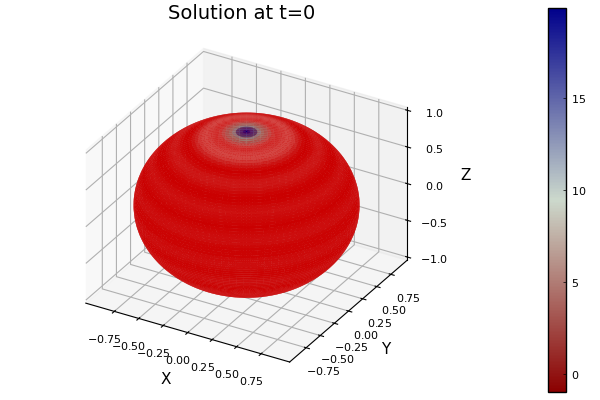

In [16]:
surface(X,Y,Z,fill_z=real.(Solutions[1,:,:]),c=:redsblues,xlabel ="X",ylabel="Y",zlabel="Z",title="Solution at t=0")

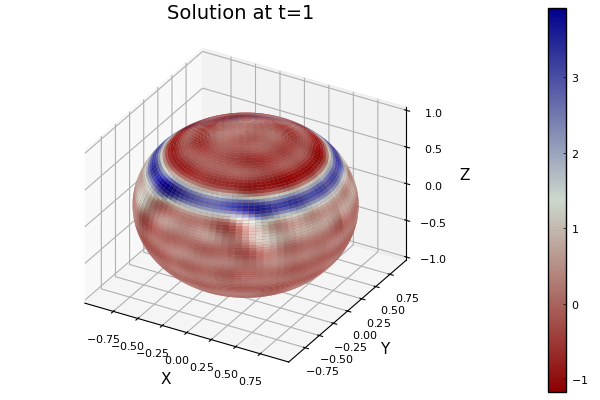

In [17]:
surface(X,Y,Z,fill_z=real.(Solutions[10,:,:]),c=:redsblues,xlabel ="X",ylabel="Y",zlabel="Z",title="Solution at t=1")

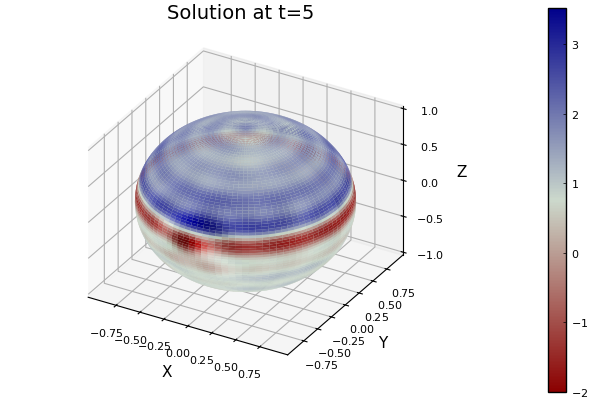

In [18]:
surface(X,Y,Z,fill_z=real.(Solutions[50,:,:]),c=:redsblues,xlabel ="X",ylabel="Y",zlabel="Z",title="Solution at t=5")

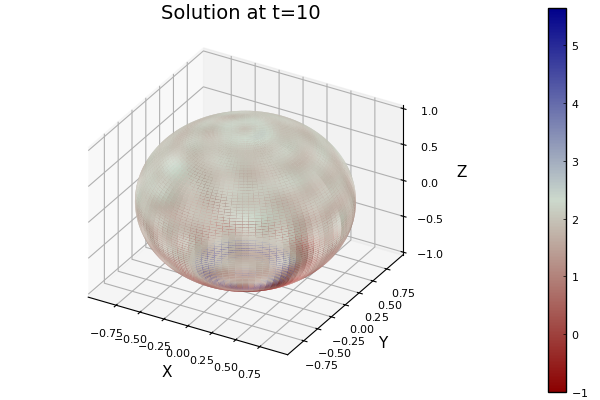

In [19]:
surface(X,Y,Z,fill_z=real.(Solutions[100,:,:]),c=:redsblues,xlabel ="X",ylabel="Y",zlabel="Z",title="Solution at t=10")

**(d) Create a series of figures or a movie that shows how the solution $\phi$ evolves in time. Perform the simulation three times with different choices of $l_{max}$, and at least one of these with a small $l_{max}$ (e.g., $l_{max} = 4$) to study the influence of the cut-off $l_{max}$.**

In [39]:
# Initializing l_max values
l_max1 = 4;
l_max2 = 10;
l_max3 = 20;

# Initial conditions in terms of coefficients C_lm (with random first derivatives)
C01 = C_lm(Gaussian, l_max1);
Der_C01 = rand(length(C01));

C02 = C_lm(Gaussian, l_max2);
Der_C02 = rand(length(C02));

C03 = C_lm(Gaussian, l_max3);
Der_C03 = rand(length(C03));

# Defining l,m values for each c
lm_1 = lm(l_max1); 
lm_2 = lm(l_max2); 
lm_3 = lm(l_max3); 

# C_lm arrays 
C1_t = []
C2_t = []
C3_t = []


Any[]

In [40]:
# Solving the differential equations for C_lm(t)\

# Arrays to store solutions
SolnArray1 = []
SolnArray2 = []
SolnArray3 = []

# l_max=4
# Solve the ODE for each l,m value
for i in 1:length(lm_1)
    l = lm_1[i]
    prob = ODEProblem(ODE_system!, [C01[i], Der_C01[i]], trange, [l])
    Sol1 = solve(prob)
    push!(SolnArray1, Sol1)
end

# l_max=10
# Solve the ODE for each l,m value
for i in 1:length(lm_2)
    l = lm_2[i]
    prob = ODEProblem(ODE_system!, [C02[i], Der_C02[i]], trange, [l])
    Sol2 = solve(prob)
    push!(SolnArray2, Sol2)
end

# l_max=20
# Solve the ODE for each l,m value
for i in 1:length(lm_3)
    l = lm_3[i]
    prob = ODEProblem(ODE_system!, [C03[i], Der_C03[i]], trange, [l])
    Sol3 = solve(prob)
    push!(SolnArray3, Sol3)
end

In [41]:
# Converting coefficients C_lm(t) into function φ(t)

# l_max = 4
for i in 1:length(lm_1)
    push!(C1_t,[x[1] for x in real.(SolnArray1[i](0:dt:10))])
end

C1_t = hcat(C1_t...);

# l_max = 10
for i in 1:length(lm_2)
    push!(C2_t,[x[1] for x in real.(SolnArray2[i](0:dt:10))])
end

C2_t = hcat(C2_t...);

# l_max = 20
for i in 1:length(lm_3)
    push!(C3_t,[x[1] for x in real.(SolnArray3[i](0:dt:10))])
end

C3_t = hcat(C3_t...);

Solutions1 = zeros(101,100,100)
Solutions2 = zeros(101,100,100)
Solutions3 = zeros(101,100,100)
for k in 1:101
    for l in 1:100
        for m in 1:100
            Solutions1[k,l,m] = C1_t[k,:]' * real.(computeYlm(0 + pi/100 * l, 0 + pi/50 * m, 4))
            Solutions2[k,l,m] = C2_t[k,:]' * real.(computeYlm(0 + pi/100 * l, 0 + pi/50 * m, 10))
            Solutions3[k,l,m] = C3_t[k,:]' * real.(computeYlm(0 + pi/100 * l, 0 + pi/50 * m, 20))
        end
    end
end


## Animations

### $l_{max}=4$

[ Info: Saved animation to C:\Users\mbrnovic\Downloads\tmp.gif


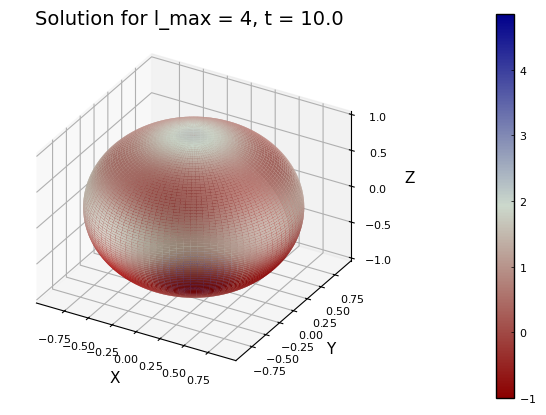

Plots.AnimatedGif("C:\\Users\\mbrnovic\\Downloads\\tmp.gif")
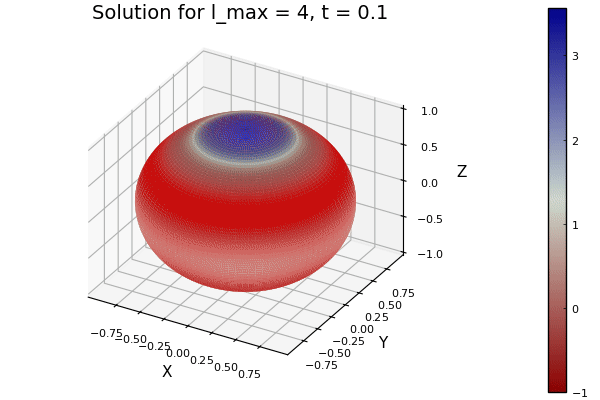

In [42]:
@gif for i in 1:100
    surface(X, Y, Z, fill_z = Solutions1[i,:,:], c=:redsblues, xlabel = "X", ylabel = "Y", zlabel = "Z", title = "Solution for l_max = 4, t = $(i/10)")
end

### $l_{max}=10$

[ Info: Saved animation to C:\Users\mbrnovic\Downloads\tmp.gif


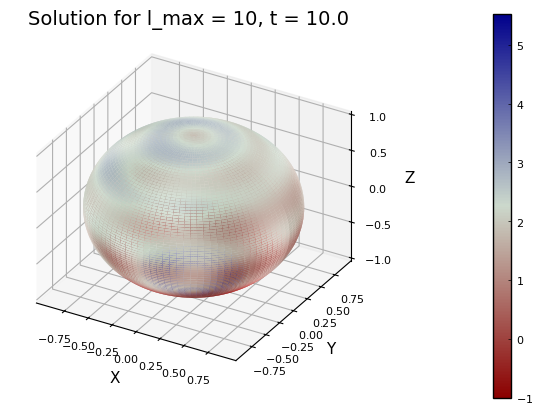

Plots.AnimatedGif("C:\\Users\\mbrnovic\\Downloads\\tmp.gif")
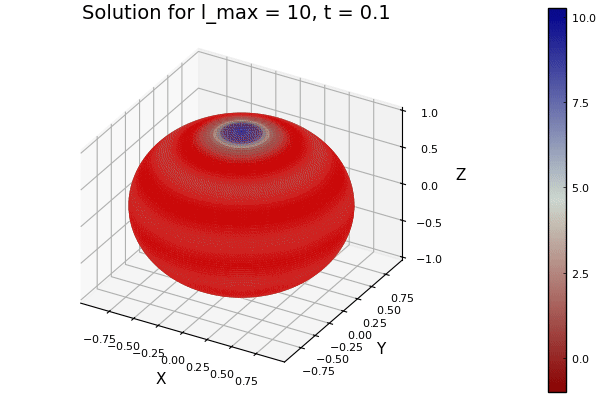

In [43]:
@gif for i in 1:100
    surface(X, Y, Z, fill_z = Solutions2[i,:,:], c=:redsblues, xlabel = "X", ylabel = "Y", zlabel = "Z", title = "Solution for l_max = 10, t = $(i/10)")
end

### $l_{max}=20$

[ Info: Saved animation to C:\Users\mbrnovic\Downloads\tmp.gif


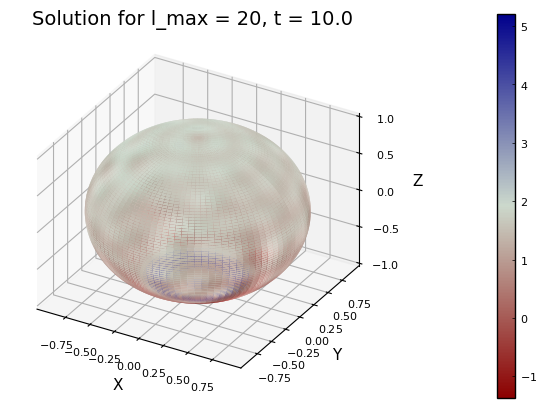

Plots.AnimatedGif("C:\\Users\\mbrnovic\\Downloads\\tmp.gif")
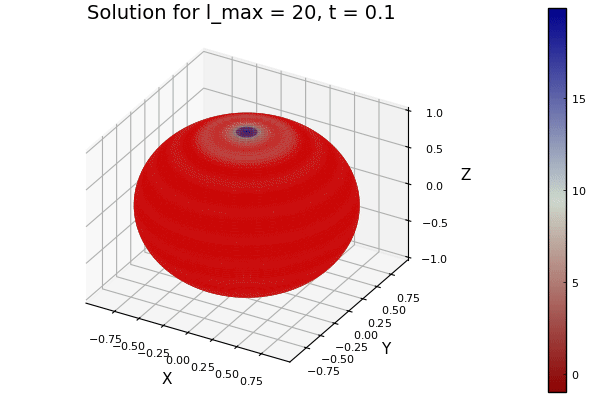

In [44]:
@gif for i in 1:100
    surface(X, Y, Z, fill_z = Solutions3[i,:,:], c=:redsblues, xlabel = "X", ylabel = "Y", zlabel = "Z", title = "Solution for l_max = 20, t = $(i/10)")
end

# Acknowledgements
* I would like to thank **Marko** for sharing his approach to plotting the results
* I've used ChatGPT at various points in this homework to get help with the syntax in Julia